# Deeper gradcam explanations

Goal: show explanations at different moments of the model's prediction process:
- source Image,
- Ig
- Gradcam 25%
- gradcam50%
- gradcam75%
- gradcam100%
- Kernelshap

Models:
- Deit S,
- PVT
- Swin
- ResNet18
- convnext v2

---

In [1]:
# device = 'cpu'
device = 'cuda'

## Imports

In [2]:
import os
current_file_dir = os.getcwd()
os.chdir("../../codes/")

from src.datasets import Imagenette2Manager

from src.models import DeiT_S, PyramidViT_V2_B2, Swin_T, ResNet18, ConvNeXtV2_Nano, Model

from src.explanations import ExplanationKernelSHAP, ExplanationGradCAM, ExplanationIntegratedGradients

# from src.load_explanations import load_explanations_of_many_models, _unify_lenths, _trim_image_path
# from src import strings_to_classes_mappings, utils

os.chdir(current_file_dir)

import imagenette_classes_mapping

## Dataset

In [3]:
import os

dataset_path = os.path.join(os.pardir, os.pardir, 'datasets', 'imagenette2', 'train')
root_explanations_path = os.path.join('explanations_dummy')

In [4]:
dataset_manager = Imagenette2Manager(dataset_path, root_explanations_path)
dataset_kwargs = {
    'batch_size': 1,
    'shuffle': True,
}

## Models

In [5]:
all_model_names = ['DeiT_S', 'Swin_T', 'PyramidViT_V2_B2', 'ResNet18', 'ConvNeXtV2_Nano']

all_models_classes = {
    'DeiT_S': DeiT_S,
    'Swin_T': Swin_T,
    'PyramidViT_V2_B2': PyramidViT_V2_B2,
    'ResNet18': ResNet18,
    'ConvNeXtV2_Nano': ConvNeXtV2_Nano,
}

## Explanation methods

In [6]:
all_explanation_methods_names = ["Integrated Gradients", "Grad-CAM", "KernelSHAP"]

In [7]:
all_explanation_methods_classes = {
    "Integrated Gradients": ExplanationIntegratedGradients,
    "Grad-CAM": ExplanationGradCAM,
    "KernelSHAP": ExplanationKernelSHAP,
}

## Get sample explanations

In [8]:
model_name = 'DeiT_S'
# explanation_method_name = 'Integrated Gradients'
explanation_method_name = 'Grad-CAM'
# explanation_method_name = 'KernelSHAP'

model = all_models_classes[model_name]()
dataset_manager = Imagenette2Manager(dataset_path, root_explanations_path)
dataloader = dataset_manager.get_dataloader(model=model, **dataset_kwargs)

explanation_method = all_explanation_methods_classes[explanation_method_name](device)
explanation_method.before_computing_explanations(model)
images, labels, paths = next(iter(dataloader))

# explanation_method.after_computing_explanations(model)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k


In [9]:
explanations, predicted_labels = explanation_method.compute_explanation(model, images)
explanation = explanations[0]

In [10]:
predicted_labels

[701]

In [11]:
model(images.to(device)).max(1).indices

tensor([701], device='cuda:0')

In [12]:
explanation.shape

(224, 224)

In [13]:
from matplotlib.colors import LinearSegmentedColormap
import copy
import numpy as np
import cv2

# explanation = copy.deepcopy(explanation)
# cmap = LinearSegmentedColormap.from_list("red-white-green", ["red", "white", "green"])
# vmin, vmax = -1, 1
# attribution_normalized = 255 * (explanation - vmin) / (vmax - vmin)
# attribution_normalized = np.clip(attribution_normalized, 0, 255).astype(np.uint8)    
# attribution_colored = cmap(attribution_normalized / 255.0)[:, :, :3] 
# attribution_colored = (attribution_colored * 255).astype(np.uint8)     
# attribution_colored_bgr = cv2.cvtColor(attribution_colored, cv2.COLOR_RGB2BGR)

explanation = copy.deepcopy(explanation)
cmap = LinearSegmentedColormap.from_list("white-green", ["white", "green"])
vmin, vmax = 0, 1
attribution_normalized = 255 * (explanation - vmin) / (vmax - vmin)
attribution_normalized = attribution_normalized.astype(np.uint8)    
attribution_colored = cmap(attribution_normalized / 255.0)[:, :, :3] 
attribution_colored = (attribution_colored * 255).astype(np.uint8)     
attribution_colored_bgr = cv2.cvtColor(attribution_colored, cv2.COLOR_RGB2BGR)    

def process_explanation_to_image(explanation):
    explanation = copy.deepcopy(explanation)
    cmap = LinearSegmentedColormap.from_list("red-white-green", ["red", "white", "green"])
    vmin, vmax = -1, 1
    attribution_normalized = 255 * (explanation - vmin) / (vmax - vmin)
    attribution_normalized = np.clip(attribution_normalized, 0, 255).astype(np.uint8)    
    attribution_colored = cmap(attribution_normalized / 255.0)[:, :, :3] 
    attribution_colored = (attribution_colored * 255).astype(np.uint8)     
    attribution_colored_bgr = cv2.cvtColor(attribution_colored, cv2.COLOR_RGB2BGR)   
    return attribution_colored_bgr


def process_explanation_to_image(explanation):
    explanation = copy.deepcopy(explanation)
    cmap = LinearSegmentedColormap.from_list("white-green", ["white", "green"])
    vmin, vmax = 0, 1
    attribution_normalized = 255 * (explanation - vmin) / (vmax - vmin)
    attribution_normalized = attribution_normalized.astype(np.uint8)    
    attribution_colored = cmap(attribution_normalized / 255.0)[:, :, :3] 
    attribution_colored = (attribution_colored * 255).astype(np.uint8)     
    attribution_colored_bgr = cv2.cvtColor(attribution_colored, cv2.COLOR_RGB2BGR)  
    return attribution_colored_bgr

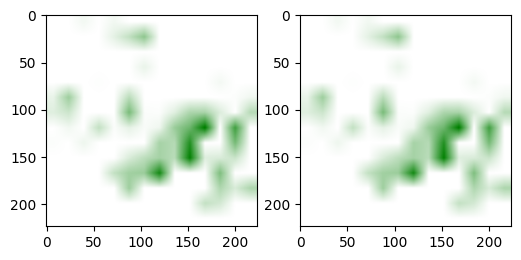

In [14]:
# matplotlib plot attribution_colored_bgr side by side twice
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(6,4))
ax[0].imshow(attribution_colored_bgr)
ax[1].imshow(attribution_colored_bgr)
plt.show()

In [15]:
images.shape

torch.Size([1, 3, 224, 224])

In [16]:
predicted_labels[0]

701

In [17]:
labels[0].item()

9

In [18]:
paths[0]

'..\\..\\datasets\\imagenette2\\train\\n03888257\\n03888257_4446.JPEG'

## Iterate over many images

In [19]:
def get_class_codename_from_prediction(predicted_label):
    return imagenette_classes_mapping.imagenette2_id_to_class_mapping[predicted_label]

def get_class_name_from_prediction(predicted_label):
    return imagenette_classes_mapping.imagenette2_class_to_name_mapping[get_class_codename_from_prediction(predicted_label)]

In [20]:
# limit of images to explain
total_images_to_explain = 5
images_to_skip = [1, 2] # starting from 1

results = []

model_name = 'DeiT_S'

# explanation_method_name = 'Integrated Gradients'
explanation_method_name = 'Grad-CAM'
# explanation_method_name = 'KernelSHAP'

model = all_models_classes[model_name]()
dataset_manager = Imagenette2Manager(dataset_path, root_explanations_path)
dataloader = dataset_manager.get_dataloader(model=model, **dataset_kwargs)
explanation_method = all_explanation_methods_classes[explanation_method_name](device)
explanation_method.before_computing_explanations(model)


counter_of_explained_images = 0
while counter_of_explained_images < total_images_to_explain:
    images, labels, paths = next(iter(dataloader))
    counter_of_explained_images += 1
    if counter_of_explained_images in images_to_skip:
        continue
    explanations, predicted_labels = explanation_method.compute_explanation(model, images)
    result = {
        'model_name': model.name,
        'image': images[0],
        'label': get_class_name_from_prediction(labels[0].item()),
        'path': paths[0],
        'explanation': explanations[0],
        'predicted_label': get_class_name_from_prediction(predicted_labels[0]),
    }
    results.append(result)


explanation_method.after_computing_explanations(model)

results[0]['predicted_label'], results[0]['label']

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k


('golf_ball', 'golf_ball')

In [21]:
len(results), results

(3,
 [{'model_name': 'DeiT_S',
   'image': tensor([[[-1.6042, -1.6042, -1.5870,  ...,  2.1804,  1.8893,  1.9407],
            [-1.6384, -1.5870, -1.5357,  ...,  2.2318,  2.0605,  1.9749],
            [-1.6213, -1.5699, -1.5185,  ...,  2.2318,  2.1119,  2.0092],
            ...,
            [-0.7993, -0.7479, -0.6965,  ..., -0.4226, -0.9020, -1.1589],
            [-0.7650, -0.6794, -0.6452,  ...,  0.6906,  0.4851,  0.2796],
            [-0.5938, -0.5082, -0.5424,  ...,  0.9303,  0.7933,  0.6563]],
   
           [[-1.3004, -1.2304, -1.2479,  ...,  2.4111,  2.3235,  2.3585],
            [-1.2829, -1.2129, -1.1779,  ...,  2.4286,  2.3761,  2.3761],
            [-1.2829, -1.2129, -1.1954,  ...,  2.4286,  2.3761,  2.3761],
            ...,
            [-0.5651, -0.5126, -0.4426,  ..., -0.2850, -0.7577, -1.0378],
            [-0.5126, -0.4076, -0.3550,  ...,  0.8704,  0.6604,  0.4503],
            [-0.3025, -0.1975, -0.2325,  ...,  1.1331,  0.9755,  0.8354]],
   
           [[-1.5081, -1.455

In [22]:
import pandas as pd

df = pd.DataFrame(results)
df

,model_name,image,label,path,explanation,predicted_label
0,DeiT_S,"[[[tensor(-1.6042), tensor(-1.6042), tensor(-1...",golf_ball,..\..\datasets\imagenette2\train\n03445777\n03...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",golf_ball
1,DeiT_S,"[[[tensor(2.1804), tensor(2.1804), tensor(2.18...",parachute,..\..\datasets\imagenette2\train\n03888257\n03...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",parachute
2,DeiT_S,"[[[tensor(-0.4568), tensor(-1.1760), tensor(-1...",chain_saw,..\..\datasets\imagenette2\train\n03000684\n03...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",chain_saw


## Iterate over many explanation methods

In [23]:
import torch

def compute_explanations(model_name, explanation_method_name, total_images_to_explain, images_to_skip=[], 
                         dataset_path=dataset_path, root_explanations_path=root_explanations_path, 
                         dataset_kwargs=dataset_kwargs, all_models_classes=all_models_classes, 
                         all_explanation_methods_classes=all_explanation_methods_classes, 
                         device=device):

    model = all_models_classes[model_name]()
    dataset_manager = Imagenette2Manager(dataset_path, root_explanations_path)
    dataloader = dataset_manager.get_dataloader(model=model, **dataset_kwargs)
    explanation_method = all_explanation_methods_classes[explanation_method_name](device)
    explanation_method.before_computing_explanations(model)

    results = []

    counter_of_explained_images = 0
    while counter_of_explained_images < total_images_to_explain:
        images, labels, paths = next(iter(dataloader))
        counter_of_explained_images += 1
        if counter_of_explained_images in images_to_skip:
            continue
        explanations, predicted_labels = explanation_method.compute_explanation(model, images)
        result = {
            'model_name': model.name,
            'image': (images[0] * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1) + torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)).permute(1, 2, 0),
            'label': get_class_name_from_prediction(labels[0].item()),
            'path': paths[0],
            'explanation': explanations[0],
            'explanation_method_name': explanation_method_name,
            'predicted_label': get_class_name_from_prediction(predicted_labels[0]),
        }
        results.append(result)

    explanation_method.after_computing_explanations(model)
    return results


# limit of images to explain
total_images_to_explain = 4
images_to_skip = [1, 2] # starting from 1

results = []

model_name = 'DeiT_S'

# explanation_method_name = 'Integrated Gradients'
explanation_method_name = 'Grad-CAM'
# explanation_method_name = 'KernelSHAP'

results += compute_explanations(model_name, explanation_method_name, total_images_to_explain, images_to_skip)
results += compute_explanations(model_name, explanation_method_name, total_images_to_explain, images_to_skip)

len(results)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k


4

In [24]:
total_images_to_explain = 1

results = []

model_name = 'DeiT_S'

for explanation_method_name in all_explanation_methods_names:
    results += compute_explanations(model_name, explanation_method_name, total_images_to_explain)

len(results)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k


3

In [25]:

# def process_explanation_to_image(explanation):
#     explanation = copy.deepcopy(explanation)
#     cmap = LinearSegmentedColormap.from_list("red-white-green", ["red", "white", "green"])
#     vmin, vmax = -1, 1
#     attribution_normalized = 255 * (explanation - vmin) / (vmax - vmin)
#     attribution_normalized = np.clip(attribution_normalized, 0, 255).astype(np.uint8)    
#     attribution_colored = cmap(attribution_normalized / 255.0)[:, :, :3] 
#     attribution_colored = (attribution_colored * 255).astype(np.uint8)     
#     attribution_colored_bgr = cv2.cvtColor(attribution_colored, cv2.COLOR_RGB2BGR)   
#     return attribution_colored_bgr


def process_explanation_to_image(explanation):
    explanation = np.abs(explanation)
    explanation = copy.deepcopy(explanation)
    cmap = LinearSegmentedColormap.from_list("white-green", ["white", "green"])
    vmin, vmax = 0, 1
    attribution_normalized = 255 * (explanation - vmin) / (vmax - vmin)
    attribution_normalized = attribution_normalized.astype(np.uint8)    
    attribution_colored = cmap(attribution_normalized / 255.0)[:, :, :3] 
    attribution_colored = (attribution_colored * 255).astype(np.uint8)     
    attribution_colored_bgr = cv2.cvtColor(attribution_colored, cv2.COLOR_RGB2BGR)  
    return attribution_colored_bgr

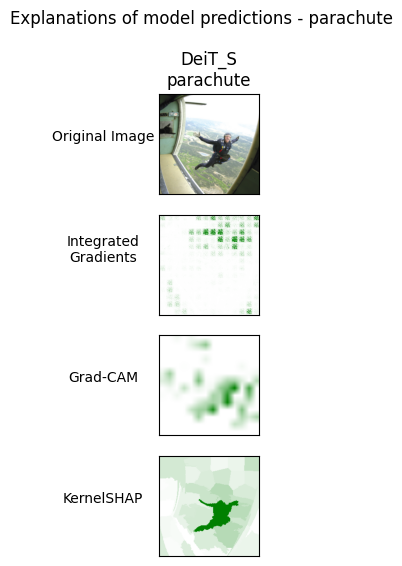

In [26]:
# plot the results, 1 column - model, 1 row - explanation method
# at each row, set y label to explanation method name
# set title of the top most plot to model name and model's prediction
# set suptitle to "Explanations of model predictions" and correct class name
import matplotlib.pyplot as plt

fig, ax = plt.subplots(4, 1, figsize=(6,6), dpi=100)

ax[0].set_title(f"{results[0]['model_name']}\n{results[0]['predicted_label']}")
# at 1st row, show the original image
ax[0].imshow(results[0]['image'])
ax[0].set_ylabel('Original Image', rotation=0, labelpad=40)
ax[0].set_xticks([]); ax[0].set_xticklabels([]); ax[0].set_xlabel(''); ax[0].set_yticks([]); ax[0].set_yticklabels([])
for i in range(len(results)):
    index_of_this_explanation_method = all_explanation_methods_names.index(results[i]['explanation_method_name'])
    ax[index_of_this_explanation_method+1].imshow(process_explanation_to_image(results[i]['explanation']))
    y_label = results[i]['explanation_method_name'] if results[i]['explanation_method_name'] != 'Integrated Gradients' else 'Integrated\nGradients'
    ax[index_of_this_explanation_method+1].set_ylabel(y_label, rotation=0, labelpad=40)
    ax[index_of_this_explanation_method+1].set_xticks([]); ax[index_of_this_explanation_method+1].set_xticklabels([]); ax[index_of_this_explanation_method+1].set_xlabel(''); ax[index_of_this_explanation_method+1].set_yticks([]); ax[index_of_this_explanation_method+1].set_yticklabels([])

plt.suptitle(f"Explanations of model predictions - {results[0]['predicted_label']}", y=1.02)

plt.show()

## Add many models

In [27]:
total_images_to_explain = 1

results = []

for model_name in all_model_names:
    for explanation_method_name in all_explanation_methods_names:
        results += compute_explanations(model_name, explanation_method_name, total_images_to_explain)

len(results)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/pvt_v2_b2.in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/pvt_v2_b2.in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/pvt_v2_b2.in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/resnet18d.ra2_in1k
Loaded default imagenet-pretrain

15

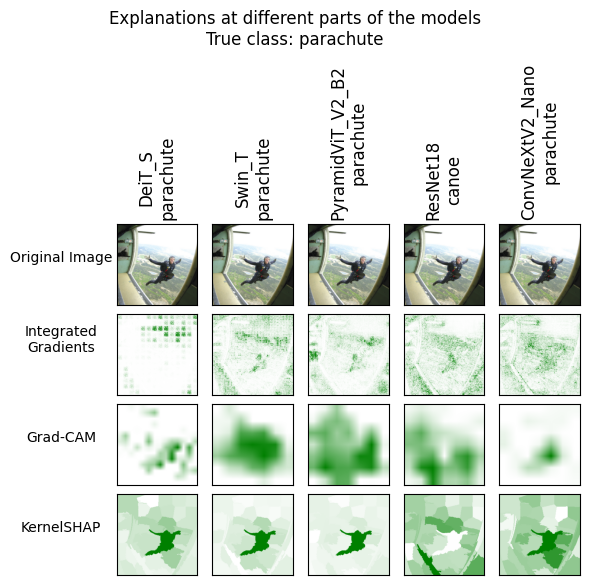

In [28]:
# plot the results, 1 column per model, 1 row - explanation method
# at each row, set y label to explanation method name
# set title of the top most plot to model name and model's prediction
# set suptitle to "Explanations of model predictions" and correct class name
import matplotlib.pyplot as plt

fig, ax = plt.subplots(int(len(results)/len(all_model_names) + 1), len(all_model_names), figsize=(6,6), dpi=100)

for j in range(len(results)):
    index_of_this_model = all_model_names.index(results[j]['model_name'])
    ax[0, index_of_this_model].set_title(f"{results[j]['model_name']}\n{results[j]['predicted_label']}", rotation=90)
    # at 1st row, show the original image
    ax[0, index_of_this_model].imshow(results[j]['image'])
    if index_of_this_model == 0:
        ax[0, index_of_this_model].set_ylabel('Original Image', rotation=0, labelpad=40)
    ax[0, index_of_this_model].set_xticks([]); ax[0, index_of_this_model].set_xticklabels([]); ax[0, index_of_this_model].set_xlabel(''); ax[0, index_of_this_model].set_yticks([]); ax[0, index_of_this_model].set_yticklabels([])
for i in range(len(results)):
    index_of_this_model = all_model_names.index(results[i]['model_name'])
    index_of_this_explanation_method = all_explanation_methods_names.index(results[i]['explanation_method_name'])
    ax[index_of_this_explanation_method+1, index_of_this_model].imshow(process_explanation_to_image(results[i]['explanation']))
    if index_of_this_model == 0:
        y_label = results[i]['explanation_method_name'] if results[i]['explanation_method_name'] != 'Integrated Gradients' else 'Integrated\nGradients'
        ax[index_of_this_explanation_method+1, index_of_this_model].set_ylabel(y_label, rotation=0, labelpad=40)
    ax[index_of_this_explanation_method+1, index_of_this_model].set_xticks([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_xticklabels([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_xlabel(''); ax[index_of_this_explanation_method+1, index_of_this_model].set_yticks([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_yticklabels([])

plt.suptitle(f"Explanations at different parts of the models\nTrue class: {results[0]['predicted_label']}")
plt.tight_layout()
# plt.savefig('explanations.png')
plt.show()

## Searching for correct layers and reshape transforms

In [29]:
## load timm models to get their layer names
import timm

from matplotlib import pyplot as plt
from pytorch_grad_cam import GradCAM

all_timm_models = {
    'DeiT_S': timm.create_model('deit_small_patch16_224.fb_in1k', pretrained=True),
    'Swin_T': timm.create_model('swin_tiny_patch4_window7_224.ms_in1k', pretrained=True),
    'PyramidViT_V2_B2': timm.create_model('pvt_v2_b2.in1k', pretrained=True),
    'ResNet18': timm.create_model('resnet18d.ra2_in1k', pretrained=True),
    'ConvNeXtV2_Nano': timm.create_model('convnextv2_nano.fcmae_ft_in22k_in1k', pretrained=True),
}


In [30]:
from pytorch_grad_cam.utils.image import show_cam_on_image
from matplotlib import pyplot as plt
from pytorch_grad_cam import GradCAM
def gradcam_print_size(tensor): 
    print(tensor.size())

In [31]:
import numpy as np
import cv2
from pytorch_grad_cam.utils.image import show_cam_on_image, preprocess_image

path_image = 'T:\\studies\\py_projects\\master_thesis\\cnn-vs-transformers-msc-thesis\\datasets\\imagenette2\\train\\n01440764\\ILSVRC2012_val_00012503.JPEG'
path_explanation = 'T:\\studies\\py_projects\\master_thesis\\cnn-vs-transformers-msc-thesis\\explanations\\imagenette2\\GradCAM\\ViT_B_32\\n01440764\\ILSVRC2012_val_00012503.npy'
path_explanation_image = 'T:\\studies\\py_projects\\master_thesis\\cnn-vs-transformers-msc-thesis\\explanations\\imagenette2\\GradCAM\\ViT_B_32\\n01440764\\ILSVRC2012_val_00012503.png'

rgb_img = cv2.imread(path_image, 1)[:, :, ::-1]
rgb_img = cv2.resize(rgb_img, (224, 224))
rgb_img = np.float32(rgb_img) / 255
input_tensor = preprocess_image(rgb_img, mean=[0.5, 0.5, 0.5],
                                    std=[0.5, 0.5, 0.5])

In [32]:
input_tensor.shape

torch.Size([1, 3, 224, 224])

#### ResNet18

In [33]:
model = all_timm_models['ResNet18'].eval()
model

ResNet(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (act1): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (drop_block): Identity()
   

In [34]:
gradcam_layers_resnet18 = {
    '25%': [model.layer1], # [1, 64, 56, 56]
    '50%': [model.layer2], # [1, 128, 28, 28]
    '75%': [model.layer3], # [1, 256, 14, 14]
    '100%': [model.layer4], # [1, 512, 7, 7], out of 4 stages, 2, 2, 8, 2 blocks
}

torch.Size([1, 64, 56, 56])
torch.Size([1, 64, 56, 56])
torch.Size([1, 128, 28, 28])
torch.Size([1, 128, 28, 28])
torch.Size([1, 256, 14, 14])
torch.Size([1, 256, 14, 14])
torch.Size([1, 512, 7, 7])
torch.Size([1, 512, 7, 7])


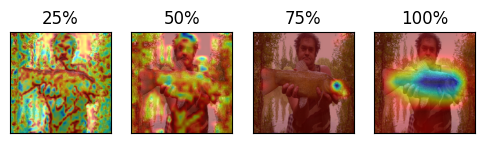

In [35]:
def gradcam_reshape_resnet18(tensor): 
    print(tensor.size())
    return tensor
            
results = []

for layer_name, target_layer in gradcam_layers_resnet18.items():
    gradcam_explanation_method = GradCAM(model=model, target_layers=target_layer, reshape_transform=gradcam_reshape_resnet18)
    explanation = gradcam_explanation_method(input_tensor=input_tensor)[0]
    ex_img = show_cam_on_image(rgb_img, explanation)
    results.append({
        'layer_name': layer_name,
        'explanation': explanation,
        'explanation_image': ex_img,
    })

fig, ax = plt.subplots(1, 4, figsize=(6,6), dpi=100)
for i in range(len(results)):
    ax[i].imshow(results[i]['explanation_image'])
    ax[i].set_title(results[i]['layer_name'])
    ax[i].set_xticks([]); ax[i].set_xticklabels([]); ax[i].set_xlabel(''); ax[i].set_yticks([]); ax[i].set_yticklabels([])

plt.show()

#### ConvNeXtV2_Nano

In [36]:
model = all_timm_models['ConvNeXtV2_Nano'].eval()
model

ConvNeXt(
  (stem): Sequential(
    (0): Conv2d(3, 80, kernel_size=(4, 4), stride=(4, 4))
    (1): LayerNorm2d((80,), eps=1e-06, elementwise_affine=True)
  )
  (stages): Sequential(
    (0): ConvNeXtStage(
      (downsample): Identity()
      (blocks): Sequential(
        (0): ConvNeXtBlock(
          (conv_dw): Conv2d(80, 80, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=80)
          (norm): LayerNorm2d((80,), eps=1e-06, elementwise_affine=True)
          (mlp): GlobalResponseNormMlp(
            (fc1): Conv2d(80, 320, kernel_size=(1, 1), stride=(1, 1))
            (act): GELU()
            (drop1): Dropout(p=0.0, inplace=False)
            (grn): GlobalResponseNorm()
            (fc2): Conv2d(320, 80, kernel_size=(1, 1), stride=(1, 1))
            (drop2): Dropout(p=0.0, inplace=False)
          )
          (shortcut): Identity()
          (drop_path): Identity()
        )
        (1): ConvNeXtBlock(
          (conv_dw): Conv2d(80, 80, kernel_size=(7, 7), stride=(1, 1), 

In [37]:
for m in model.stages:
    print(len(m.blocks))

2
2
8
2


In [38]:
gradcam_layers_convnext_v2 = {
    '25%': [model.stages[0].blocks[-1]], # [1, 80, 56, 56]
    '50%': [model.stages[1].blocks[-1]], # [1, 160, 28, 28]
    '75%': [model.stages[2].blocks[-1]], # [1, 320, 14, 14]
    '100%': [model.stages[3].blocks[-1]], # [1, 640, 7, 7], out of 4 stages, 2, 2, 8, 2 blocks
}

torch.Size([1, 80, 56, 56])
torch.Size([1, 80, 56, 56])
torch.Size([1, 160, 28, 28])
torch.Size([1, 160, 28, 28])
torch.Size([1, 320, 14, 14])
torch.Size([1, 320, 14, 14])
torch.Size([1, 640, 7, 7])
torch.Size([1, 640, 7, 7])


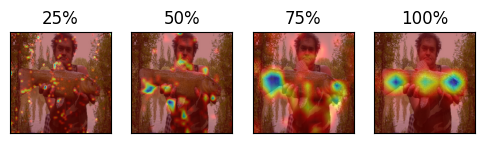

In [39]:
def gradcam_reshape_convnext_v2(tensor): 
    print(tensor.size())
    return tensor
            
results = []

for layer_name, target_layer in gradcam_layers_convnext_v2.items():
    gradcam_explanation_method = GradCAM(model=model, target_layers=target_layer, reshape_transform=gradcam_reshape_convnext_v2)
    explanation = gradcam_explanation_method(input_tensor=input_tensor)[0]
    ex_img = show_cam_on_image(rgb_img, explanation)
    results.append({
        'layer_name': layer_name,
        'explanation': explanation,
        'explanation_image': ex_img,
    })

fig, ax = plt.subplots(1, 4, figsize=(6,6), dpi=100)
for i in range(len(results)):
    ax[i].imshow(results[i]['explanation_image'])
    ax[i].set_title(results[i]['layer_name'])
    ax[i].set_xticks([]); ax[i].set_xticklabels([]); ax[i].set_xlabel(''); ax[i].set_yticks([]); ax[i].set_yticklabels([])

plt.show()

#### Swin T

In [40]:
model = all_timm_models['Swin_T'].eval()
model

SwinTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
    (norm): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
  )
  (layers): Sequential(
    (0): SwinTransformerStage(
      (downsample): Identity()
      (blocks): Sequential(
        (0): SwinTransformerBlock(
          (norm1): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
          (attn): WindowAttention(
            (qkv): Linear(in_features=96, out_features=288, bias=True)
            (attn_drop): Dropout(p=0.0, inplace=False)
            (proj): Linear(in_features=96, out_features=96, bias=True)
            (proj_drop): Dropout(p=0.0, inplace=False)
            (softmax): Softmax(dim=-1)
          )
          (drop_path1): Identity()
          (norm2): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
          (mlp): Mlp(
            (fc1): Linear(in_features=96, out_features=384, bias=True)
            (act): GELU(approximate='none')
            (drop1): 

In [41]:
for m in model.layers:
    print(len(m.blocks))

2
2
6
2


In [42]:
gradcam_layers_swin = {
    '25%': [model.layers[0].blocks[-1]], # [1, 96, 56, 56]
    '50%': [model.layers[1].blocks[-1]], # [1, 192, 28, 28]
    '75%': [model.layers[2].blocks[-1]], # [1, 384, 14, 14]
    '100%': [model.layers[3].blocks[-1]], # [1, 768, 7, 7], out of 4 stages, 2, 2, 6, 2 blocks
}

torch.Size([1, 96, 56, 56])
torch.Size([1, 96, 56, 56])
torch.Size([1, 192, 28, 28])
torch.Size([1, 192, 28, 28])
torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])
torch.Size([1, 768, 7, 7])
torch.Size([1, 768, 7, 7])


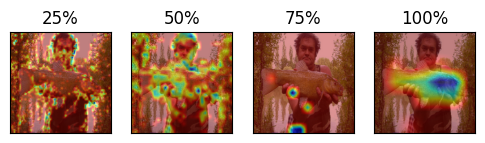

In [43]:
def gradcam_reshape_swin(tensor): 
    tensor = tensor.transpose(2, 3).transpose(1, 2)
    print(tensor.size())
    return tensor
            
results = []

for layer_name, target_layer in gradcam_layers_swin.items():
    gradcam_explanation_method = GradCAM(model=model, target_layers=target_layer, reshape_transform=gradcam_reshape_swin)
    explanation = gradcam_explanation_method(input_tensor=input_tensor)[0]
    ex_img = show_cam_on_image(rgb_img, explanation)
    results.append({
        'layer_name': layer_name,
        'explanation': explanation,
        'explanation_image': ex_img,
    })

fig, ax = plt.subplots(1, 4, figsize=(6,6), dpi=100)
for i in range(len(results)):
    ax[i].imshow(results[i]['explanation_image'])
    ax[i].set_title(results[i]['layer_name'])
    ax[i].set_xticks([]); ax[i].set_xticklabels([]); ax[i].set_xlabel(''); ax[i].set_yticks([]); ax[i].set_yticklabels([])

plt.show()

#### PVT

4 stages, after each stage

In [44]:
model = all_timm_models['PyramidViT_V2_B2'].eval()
model

PyramidVisionTransformerV2(
  (patch_embed): OverlapPatchEmbed(
    (proj): Conv2d(3, 64, kernel_size=(7, 7), stride=(4, 4), padding=(3, 3))
    (norm): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
  )
  (stages): Sequential(
    (0): PyramidVisionTransformerStage(
      (blocks): ModuleList(
        (0-2): 3 x Block(
          (norm1): LayerNorm((64,), eps=1e-06, elementwise_affine=True)
          (attn): Attention(
            (q): Linear(in_features=64, out_features=64, bias=True)
            (kv): Linear(in_features=64, out_features=128, bias=True)
            (attn_drop): Dropout(p=0.0, inplace=False)
            (proj): Linear(in_features=64, out_features=64, bias=True)
            (proj_drop): Dropout(p=0.0, inplace=False)
            (sr): Conv2d(64, 64, kernel_size=(8, 8), stride=(8, 8))
            (norm): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
          )
          (drop_path1): Identity()
          (norm2): LayerNorm((64,), eps=1e-06, elementwise_affin

In [45]:
len(model.stages)

4

In [46]:
gradcam_layers_pvt_v2 = {
    '25%': [model.stages[0].blocks[-1]], # [1, 64, 56, 56]
    '50%': [model.stages[1].blocks[-1]], # [1, 128, 28, 28]
    '75%': [model.stages[2].blocks[-1]], # [1, 320, 14, 14]
    '100%': [model.stages[3].blocks[-1]], # [1, 512, 7, 7], out of 4 stages, each with 3 blocks => 12 blocks
}

torch.Size([1, 64, 56, 56])
torch.Size([1, 64, 56, 56])
torch.Size([1, 128, 28, 28])
torch.Size([1, 128, 28, 28])
torch.Size([1, 320, 14, 14])
torch.Size([1, 320, 14, 14])
torch.Size([1, 512, 7, 7])
torch.Size([1, 512, 7, 7])


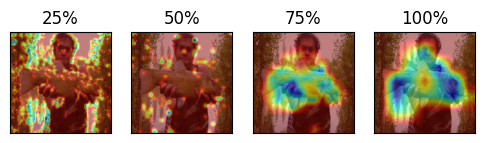

In [47]:
def gradcam_reshape_pvt_v2(tensor):
    tensor = tensor.reshape(tensor.size(0), int(tensor.size(1)**0.5), int(tensor.size(1)**0.5), tensor.size(2))
    tensor = tensor.transpose(2, 3).transpose(1, 2)
    print(tensor.size())
    return tensor

results = []

for layer_name, target_layer in gradcam_layers_pvt_v2.items():
    gradcam_explanation_method = GradCAM(model=model, target_layers=target_layer, reshape_transform=gradcam_reshape_pvt_v2)
    explanation = gradcam_explanation_method(input_tensor=input_tensor)[0]
    ex_img = show_cam_on_image(rgb_img, explanation)
    results.append({
        'layer_name': layer_name,
        'explanation': explanation,
        'explanation_image': ex_img,
    })

fig, ax = plt.subplots(1, 4, figsize=(6,6), dpi=100)
for i in range(len(results)):
    ax[i].imshow(results[i]['explanation_image'])
    ax[i].set_title(results[i]['layer_name'])
    ax[i].set_xticks([]); ax[i].set_xticklabels([]); ax[i].set_xlabel(''); ax[i].set_yticks([]); ax[i].set_yticklabels([])

plt.show()

#### DeiT S

12 blocks
- 25%: 2
- 50%: 5
- 75%: 8
- 100%: 11.5

In [48]:
model = all_timm_models['DeiT_S']
model

VisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 384, kernel_size=(16, 16), stride=(16, 16))
    (norm): Identity()
  )
  (pos_drop): Dropout(p=0.0, inplace=False)
  (patch_drop): Identity()
  (norm_pre): Identity()
  (blocks): Sequential(
    (0): Block(
      (norm1): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=384, out_features=1152, bias=True)
        (q_norm): Identity()
        (k_norm): Identity()
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=384, out_features=384, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (ls1): Identity()
      (drop_path1): Identity()
      (norm2): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
      (mlp): Mlp(
        (fc1): Linear(in_features=384, out_features=1536, bias=True)
        (act): GELU(approximate='none')
        (drop1): Dropout(p=0.0, inplace=False)
        (norm): Identity(

In [49]:
len(model.blocks)

12

In [50]:
gradcam_layers_deit = {
    '25%': [model.blocks[2]],
    '50%': [model.blocks[5]],
    '75%': [model.blocks[8]],
    '100%': [model.blocks[10]], # out of 12, all have same shape [1, 384, 14, 14]
}

torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])
torch.Size([1, 384, 14, 14])


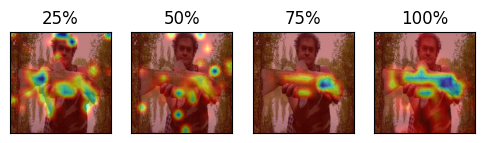

In [51]:
results = []

def gradcam_reshape_deit(tensor): 
    result = tensor[:, 1:, :] # remove class token
    result = result.reshape(tensor.size(0), 14, 14, tensor.size(2))
    result = result.transpose(2, 3).transpose(1, 2)
    print(result.shape)
    return result

for layer_name, target_layer in gradcam_layers_deit.items():
    gradcam_explanation_method = GradCAM(model=model, target_layers=target_layer, reshape_transform=gradcam_reshape_deit)
    explanation = gradcam_explanation_method(input_tensor=input_tensor)[0]
    ex_img = show_cam_on_image(rgb_img, explanation)
    results.append({
        'layer_name': layer_name,
        'explanation': explanation,
        'explanation_image': ex_img,
    })

fig, ax = plt.subplots(1, 4, figsize=(6,6), dpi=100)
for i in range(len(results)):
    ax[i].imshow(results[i]['explanation_image'])
    ax[i].set_title(results[i]['layer_name'])
    ax[i].set_xticks([]); ax[i].set_xticklabels([]); ax[i].set_xlabel(''); ax[i].set_yticks([]); ax[i].set_yticklabels([])

plt.show()

## Grad-CAM at different layers

In [52]:
gradcam_layers_resnet18 = lambda model: {
    '25%': [model.model.layer1], # [1, 64, 56, 56]
    '50%': [model.model.layer2], # [1, 128, 28, 28]
    '75%': [model.model.layer3], # [1, 256, 14, 14]
    '100%': [model.model.layer4], # [1, 512, 7, 7], out of 4 stages, 2, 2, 8, 2 blocks
}

gradcam_layers_convnext_v2 = lambda model: {
    '25%': [model.model.stages[0].blocks[-1]], # [1, 80, 56, 56]
    '50%': [model.model.stages[1].blocks[-1]], # [1, 160, 28, 28]
    '75%': [model.model.stages[2].blocks[-1]], # [1, 320, 14, 14]
    '100%': [model.model.stages[3].blocks[-1]], # [1, 640, 7, 7], out of 4 stages, 2, 2, 8, 2 blocks
}

gradcam_layers_pvt_v2 = lambda model: {
    '25%': [model.model.stages[0].blocks[-1]], # [1, 64, 56, 56]
    '50%': [model.model.stages[1].blocks[-1]], # [1, 128, 28, 28]
    '75%': [model.model.stages[2].blocks[-1]], # [1, 320, 14, 14]
    '100%': [model.model.stages[3].blocks[-1]], # [1, 512, 7, 7], out of 4 stages, each with 3 blocks => 12 blocks
}

gradcam_layers_swin = lambda model: {
    '25%': [model.model.layers[0].blocks[-1]], # [1, 96, 56, 56]
    '50%': [model.model.layers[1].blocks[-1]], # [1, 192, 28, 28]
    '75%': [model.model.layers[2].blocks[-1]], # [1, 384, 14, 14]
    '100%': [model.model.layers[3].blocks[-1]], # [1, 768, 7, 7], out of 4 stages, 2, 2, 6, 2 blocks
}

gradcam_layers_deit = lambda model: {
    '25%': [model.model.blocks[2]], # [1, 384, 14, 14]
    '50%': [model.model.blocks[5]], # [1, 384, 14, 14] 
    '75%': [model.model.blocks[8]], # [1, 384, 14, 14]
    '100%': [model.model.blocks[10]], # [1, 384, 14, 14], out of 12 blocks
}

In [53]:
def gradcam_reshape_resnet18(tensor): 
    return tensor

def gradcam_reshape_convnext_v2(tensor): 
    return tensor

def gradcam_reshape_swin(tensor): 
    tensor = tensor.transpose(2, 3).transpose(1, 2)
    return tensor

def gradcam_reshape_pvt_v2(tensor): 
    tensor = tensor.reshape(tensor.size(0), int(tensor.size(1)**0.5), int(tensor.size(1)**0.5), tensor.size(2))
    tensor = tensor.transpose(2, 3).transpose(1, 2)
    return tensor

def gradcam_reshape_deit(tensor): 
    tensor = tensor[:, 1:, :]
    tensor = tensor.reshape(tensor.size(0), 14, 14, tensor.size(2))
    tensor = tensor.transpose(2, 3).transpose(1, 2)
    return tensor

In [54]:
gradcam_layers_by_model = {
    'ResNet18': gradcam_layers_resnet18,
    'ConvNeXtV2_Nano': gradcam_layers_convnext_v2,
    'Swin_T': gradcam_layers_swin,
    'PyramidViT_V2_B2': gradcam_layers_pvt_v2,
    'DeiT_S': gradcam_layers_deit,
}

gradcam_reshape_by_model = {
    'ResNet18': gradcam_reshape_resnet18,
    'ConvNeXtV2_Nano': gradcam_reshape_convnext_v2,
    'Swin_T': gradcam_reshape_swin,
    'PyramidViT_V2_B2': gradcam_reshape_pvt_v2,
    'DeiT_S': gradcam_reshape_deit,
}

In [55]:
# given model, model_name and gradcam percentage, return a class of that model with swapped reshape and gradcam layers
def overwrite_gradcam_specific_settings(model, model_name, gradcam_percentage, gradcam_layers_by_model=gradcam_layers_by_model,
                                        gradcam_reshape_by_model=gradcam_reshape_by_model):
    model.make_sure_is_initialized()
    model.explanation_parameters_gradcam = {
        'target_layers': gradcam_layers_by_model[model_name](model)[gradcam_percentage],
        'reshape_transform': gradcam_reshape_by_model[model_name],
    }
    return model

def compute_explanations(model_name, explanation_method_name, total_images_to_explain, images_to_skip=[], 
                         dataset_path=dataset_path, root_explanations_path=root_explanations_path, 
                         dataset_kwargs=dataset_kwargs, all_models_classes=all_models_classes, 
                         all_explanation_methods_classes=all_explanation_methods_classes, 
                         device=device, gradcam_percentage=None, gradcam_layers_by_model=gradcam_layers_by_model,
                         gradcam_reshape_by_model=gradcam_reshape_by_model):

    model = all_models_classes[model_name]()
    if explanation_method_name == 'Grad-CAM':
        model = overwrite_gradcam_specific_settings(model, model_name, gradcam_percentage, gradcam_layers_by_model, gradcam_reshape_by_model)
    dataset_manager = Imagenette2Manager(dataset_path, root_explanations_path)
    dataloader = dataset_manager.get_dataloader(model=model, **dataset_kwargs)
    explanation_method = all_explanation_methods_classes[explanation_method_name](device)
    explanation_method.before_computing_explanations(model)

    results = []

    counter_of_explained_images = 0
    while counter_of_explained_images < total_images_to_explain:
        images, labels, paths = next(iter(dataloader))
        counter_of_explained_images += 1
        if counter_of_explained_images in images_to_skip:
            continue
        explanations, predicted_labels = explanation_method.compute_explanation(model, images)
        result = {
            'model_name': model.name,
            'image': (images[0] * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1) + torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)).permute(1, 2, 0),
            'label': get_class_name_from_prediction(labels[0].item()),
            'path': paths[0],
            'explanation': explanations[0],
            'explanation_method_name': explanation_method_name if explanation_method_name != "Grad-CAM" else f'Grad-CAM\n{gradcam_percentage}',
            'predicted_label': get_class_name_from_prediction(predicted_labels[0]),
        }
        results.append(result)

    explanation_method.after_computing_explanations(model)
    return results

In [56]:
total_images_to_explain = 1

results = []

for model_name in all_model_names:
    for explanation_method_name in all_explanation_methods_names:
        if explanation_method_name != 'Grad-CAM':
            results += compute_explanations(model_name, explanation_method_name, total_images_to_explain)
        else:
            for gradcam_percentage in ['25%', '50%', '75%', '100%']:
                results += compute_explanations(model_name, explanation_method_name, total_images_to_explain, gradcam_percentage=gradcam_percentage)

len(results)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

30

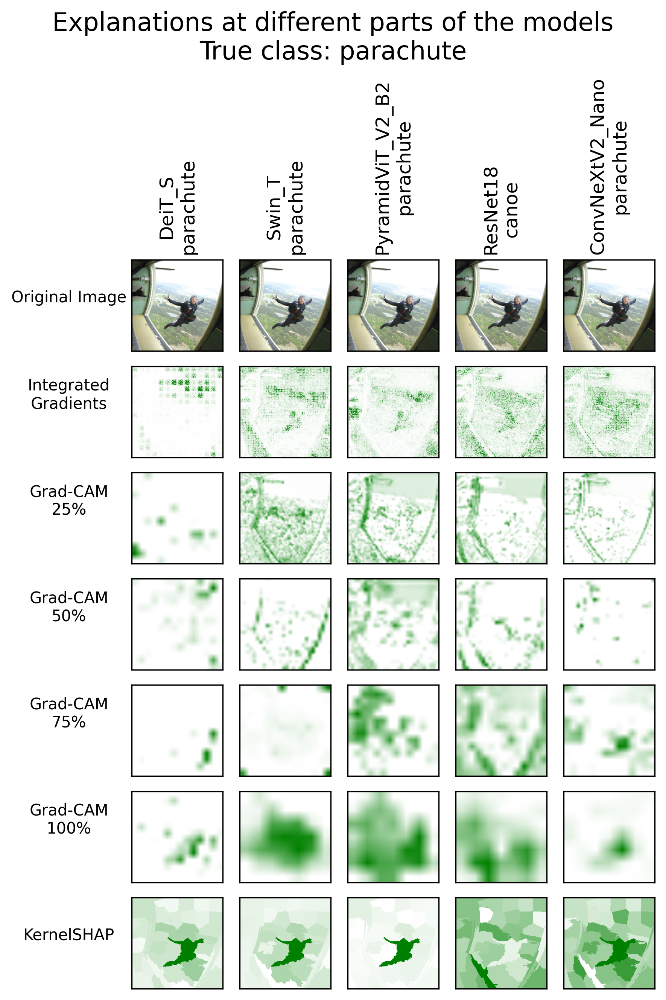

In [57]:
all_explanation_methods_names_ordered = [
    'Integrated Gradients',
    'Grad-CAM\n25%',
    'Grad-CAM\n50%',
    'Grad-CAM\n75%',
    'Grad-CAM\n100%',
    'KernelSHAP',
]

# plot the results, 1 column per model, 1 row - explanation method
# at each row, set y label to explanation method name
# set title of the top most plot to model name and model's prediction
# set suptitle to "Explanations of model predictions" and correct class name
import matplotlib.pyplot as plt

fig, ax = plt.subplots(int(len(set([a['explanation_method_name'] for a in results])) + 1), len(all_model_names), figsize=(6,9), dpi=300)

for j in range(len(results)):
    index_of_this_model = all_model_names.index(results[j]['model_name'])
    ax[0, index_of_this_model].set_title(f"{results[j]['model_name']}\n{results[j]['predicted_label']}", rotation=90)
    # at 1st row, show the original image
    ax[0, index_of_this_model].imshow(results[j]['image'])
    if index_of_this_model == 0:
        ax[0, index_of_this_model].set_ylabel('Original Image', rotation=0, labelpad=40)
    ax[0, index_of_this_model].set_xticks([]); ax[0, index_of_this_model].set_xticklabels([]); ax[0, index_of_this_model].set_xlabel(''); ax[0, index_of_this_model].set_yticks([]); ax[0, index_of_this_model].set_yticklabels([])
for i in range(len(results)):
    index_of_this_model = all_model_names.index(results[i]['model_name'])
    index_of_this_explanation_method = all_explanation_methods_names_ordered.index(results[i]['explanation_method_name'])
    ax[index_of_this_explanation_method+1, index_of_this_model].imshow(process_explanation_to_image(results[i]['explanation']))
    if index_of_this_model == 0:
        y_label = results[i]['explanation_method_name'] if results[i]['explanation_method_name'] != 'Integrated Gradients' else 'Integrated\nGradients'
        ax[index_of_this_explanation_method+1, index_of_this_model].set_ylabel(y_label, rotation=0, labelpad=40)
    ax[index_of_this_explanation_method+1, index_of_this_model].set_xticks([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_xticklabels([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_xlabel(''); ax[index_of_this_explanation_method+1, index_of_this_model].set_yticks([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_yticklabels([])

plt.suptitle(f"Explanations at different parts of the models\nTrue class: {results[0]['predicted_label']}", fontsize=16)
plt.tight_layout()
# plt.savefig('explanations.png')
plt.show()

In [58]:
# check if all predicted labels are the same
all_predictions_correct = all([a['predicted_label'] == results[0]['label'] for a in results])
all_predictions_correct

False

## Save to files

In [59]:
def plot_results_to_file(results, all_model_names=all_model_names, all_explanation_methods_names_ordered=all_explanation_methods_names_ordered):
    fig, ax = plt.subplots(int(len(set([a['explanation_method_name'] for a in results])) + 1), len(all_model_names), figsize=(6,9), dpi=300)

    for j in range(len(results)):
        index_of_this_model = all_model_names.index(results[j]['model_name'])
        ax[0, index_of_this_model].set_title(f"{results[j]['model_name']}\n{results[j]['predicted_label']}", rotation=90)
        # at 1st row, show the original image
        ax[0, index_of_this_model].imshow(results[j]['image'])
        if index_of_this_model == 0:
            ax[0, index_of_this_model].set_ylabel('Original Image', rotation=0, labelpad=40)
        ax[0, index_of_this_model].set_xticks([]); ax[0, index_of_this_model].set_xticklabels([]); ax[0, index_of_this_model].set_xlabel(''); ax[0, index_of_this_model].set_yticks([]); ax[0, index_of_this_model].set_yticklabels([])
    for i in range(len(results)):
        index_of_this_model = all_model_names.index(results[i]['model_name'])
        index_of_this_explanation_method = all_explanation_methods_names_ordered.index(results[i]['explanation_method_name'])
        ax[index_of_this_explanation_method+1, index_of_this_model].imshow(process_explanation_to_image(results[i]['explanation']))
        if index_of_this_model == 0:
            y_label = results[i]['explanation_method_name'] if results[i]['explanation_method_name'] != 'Integrated Gradients' else 'Integrated\nGradients'
            ax[index_of_this_explanation_method+1, index_of_this_model].set_ylabel(y_label, rotation=0, labelpad=40)
        ax[index_of_this_explanation_method+1, index_of_this_model].set_xticks([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_xticklabels([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_xlabel(''); ax[index_of_this_explanation_method+1, index_of_this_model].set_yticks([]); ax[index_of_this_explanation_method+1, index_of_this_model].set_yticklabels([])

    plt.suptitle(f"Explanations at different parts of the models\nTrue class: {results[0]['predicted_label']}", fontsize=16)
    plt.tight_layout()
    are_all_explanations_correct = all([a['predicted_label'] == results[0]['label'] for a in results])
    image_filename = results[0]["path"].split("\\")[-1].split(".")[0]
    plt.savefig(f'explanations_{"all-correct" if are_all_explanations_correct else "not-all-correct"}_{image_filename}.png')
    plt.show()

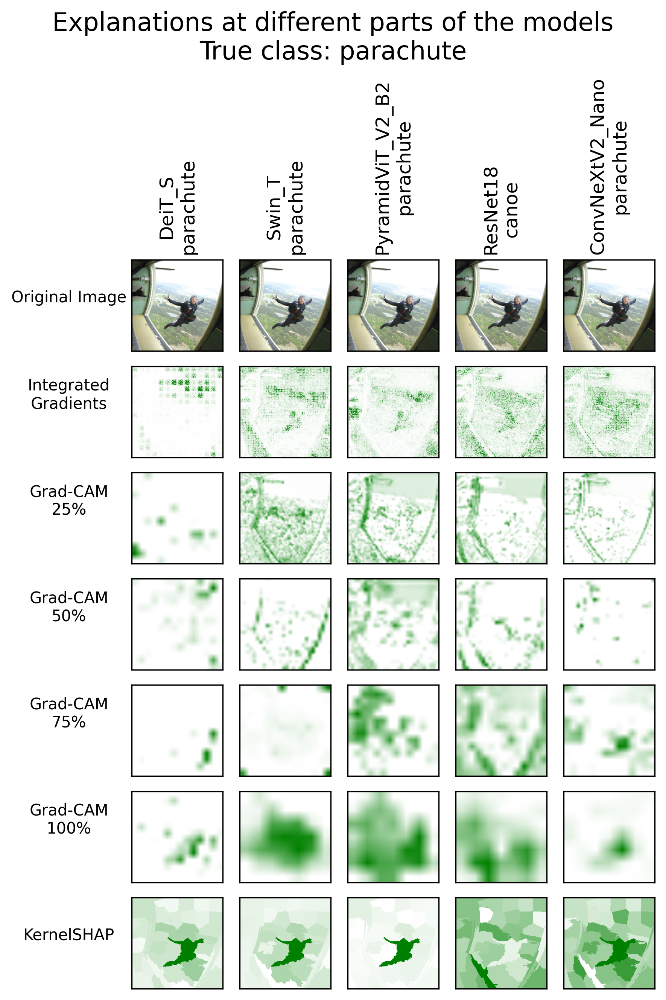

In [60]:
plot_results_to_file(results)

## Get i-th and save to file

In [61]:
def compute_for_ith_and_save_to_file(image_to_plot_id, all_model_names=all_model_names, 
                                     all_explanation_methods_names=all_explanation_methods_names,
                                     all_explanation_methods_names_ordered=all_explanation_methods_names_ordered):
    
    total_images_to_explain = image_to_plot_id + 1
    skip = [i for i in range(1, total_images_to_explain)]

    results = []

    for model_name in all_model_names:
        for explanation_method_name in all_explanation_methods_names:
            if explanation_method_name != 'Grad-CAM':
                results += compute_explanations(model_name, explanation_method_name, total_images_to_explain, images_to_skip=skip)
            else:
                for gradcam_percentage in ['25%', '50%', '75%', '100%']:
                    results += compute_explanations(model_name, explanation_method_name, total_images_to_explain, 
                                                    gradcam_percentage=gradcam_percentage, images_to_skip=skip)

    plot_results_to_file(results, all_model_names, all_explanation_methods_names_ordered)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

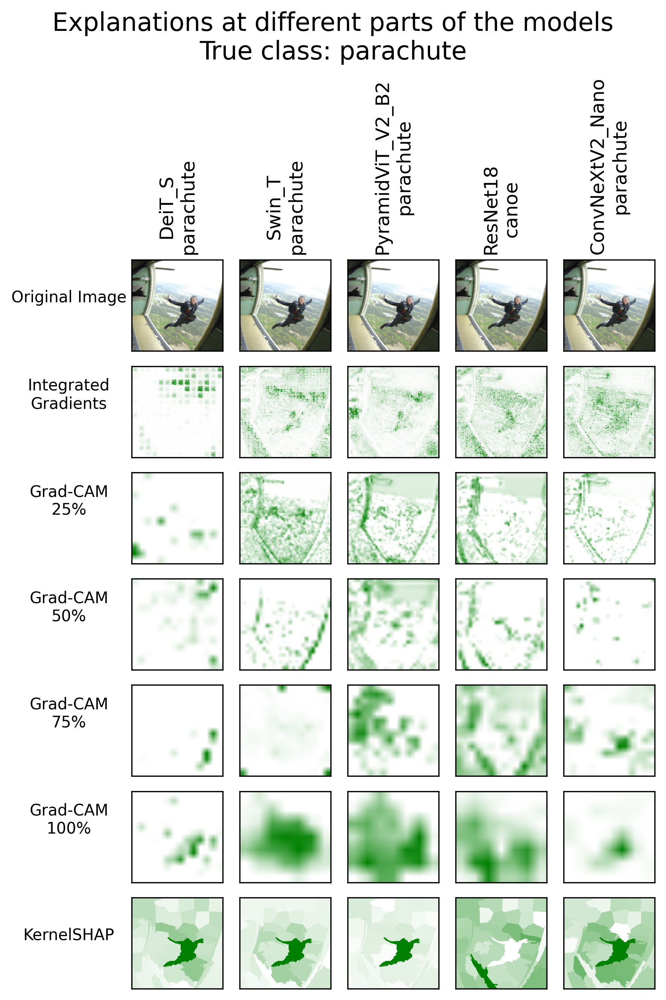

In [62]:
compute_for_ith_and_save_to_file(0)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

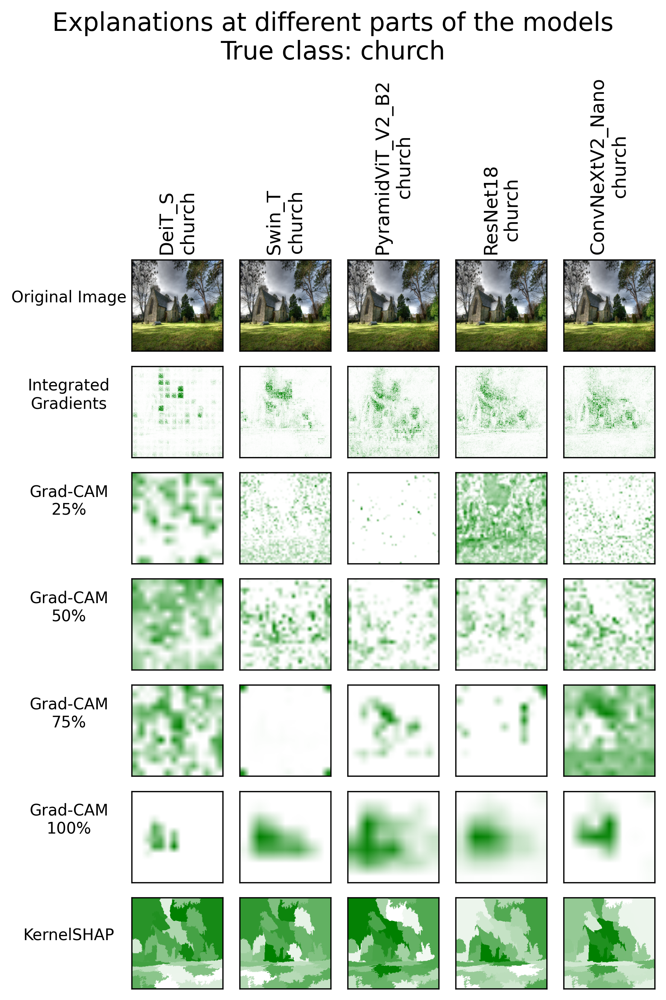

In [63]:
compute_for_ith_and_save_to_file(1)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

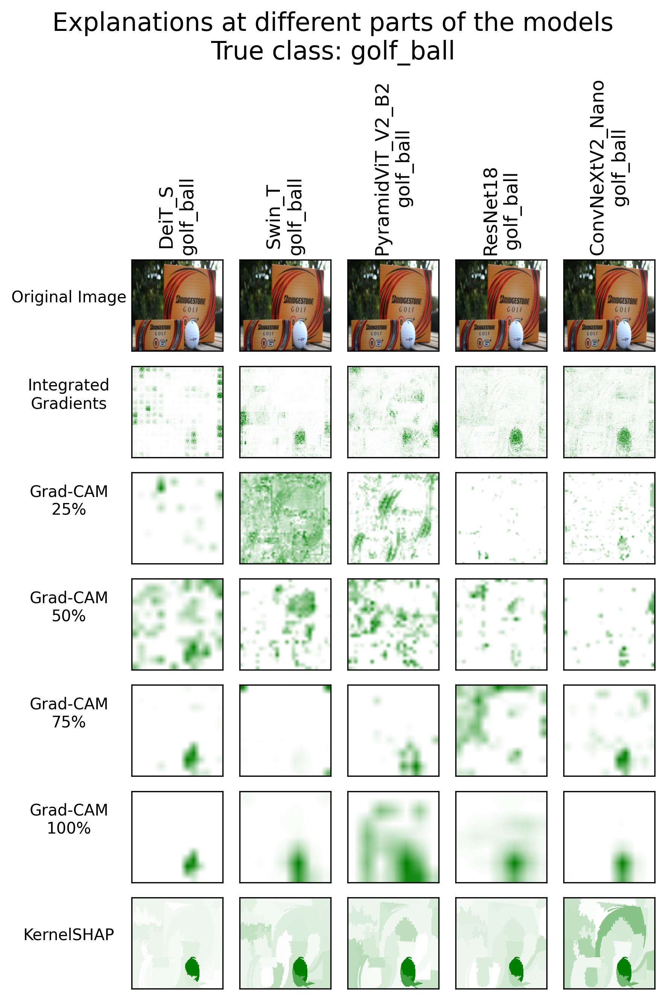

In [64]:
compute_for_ith_and_save_to_file(2)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

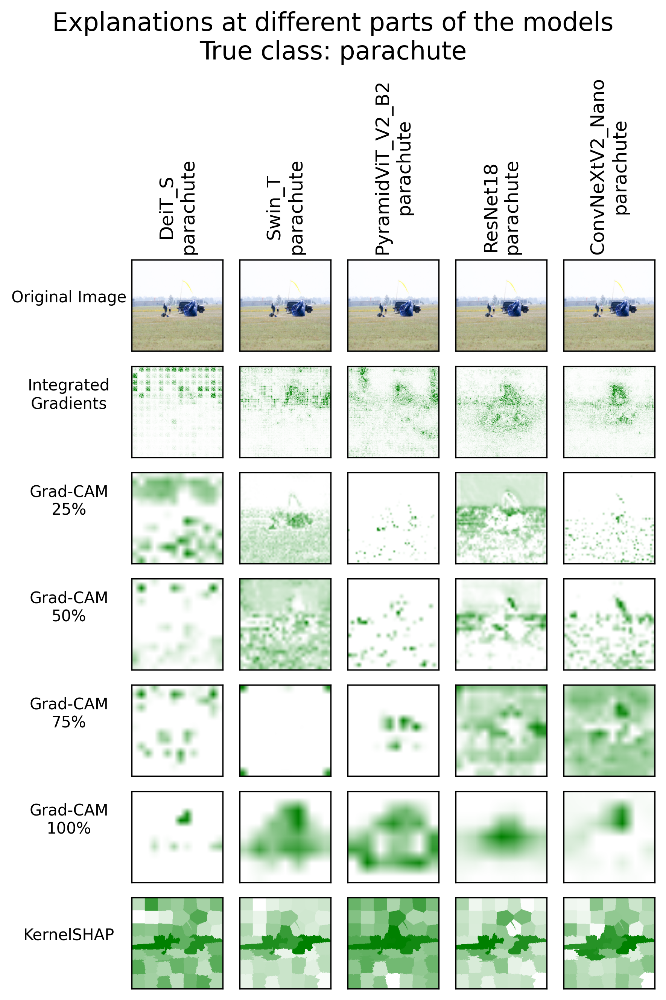

In [65]:
compute_for_ith_and_save_to_file(3)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

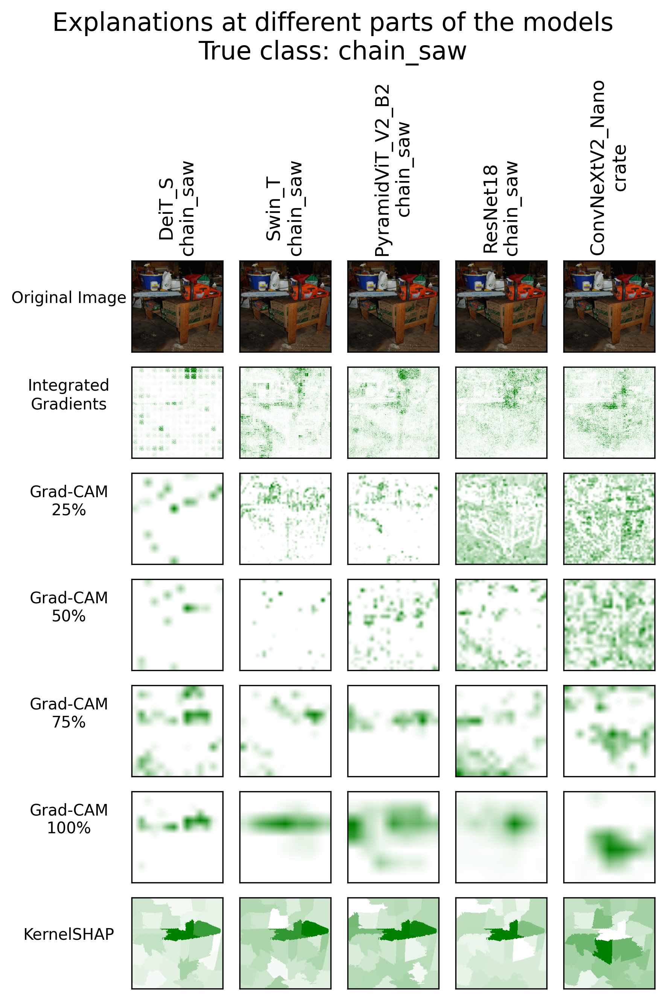

In [66]:
compute_for_ith_and_save_to_file(4)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

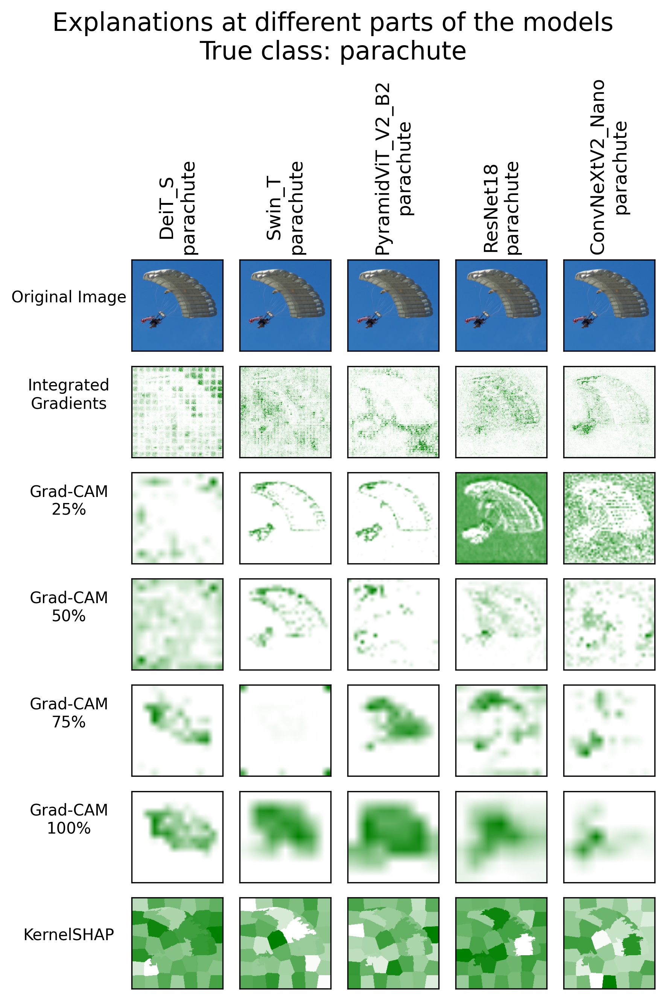

In [67]:
compute_for_ith_and_save_to_file(5)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

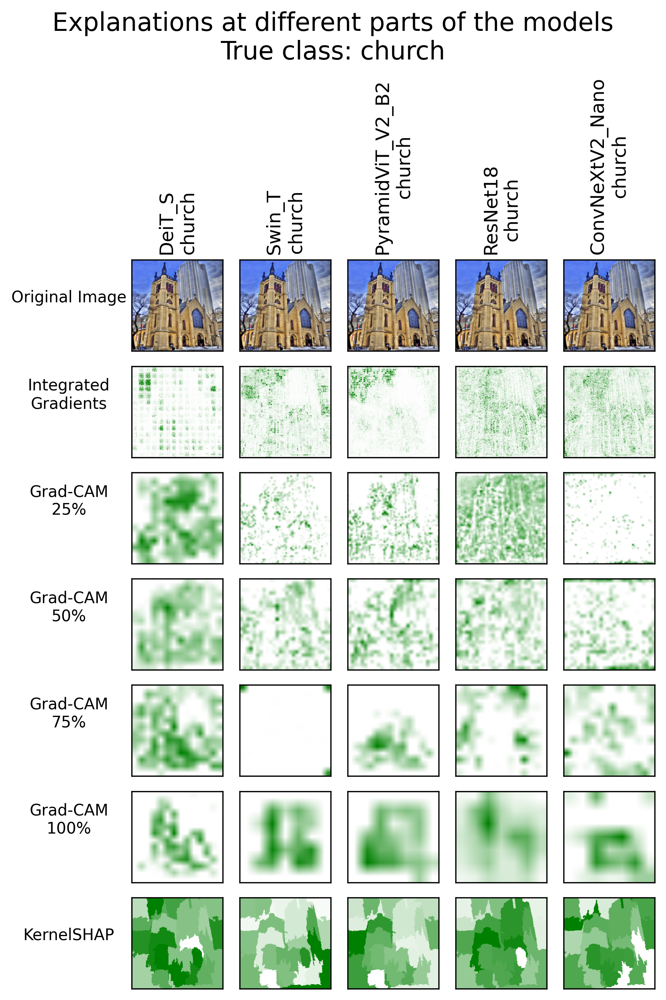

In [68]:
compute_for_ith_and_save_to_file(6)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

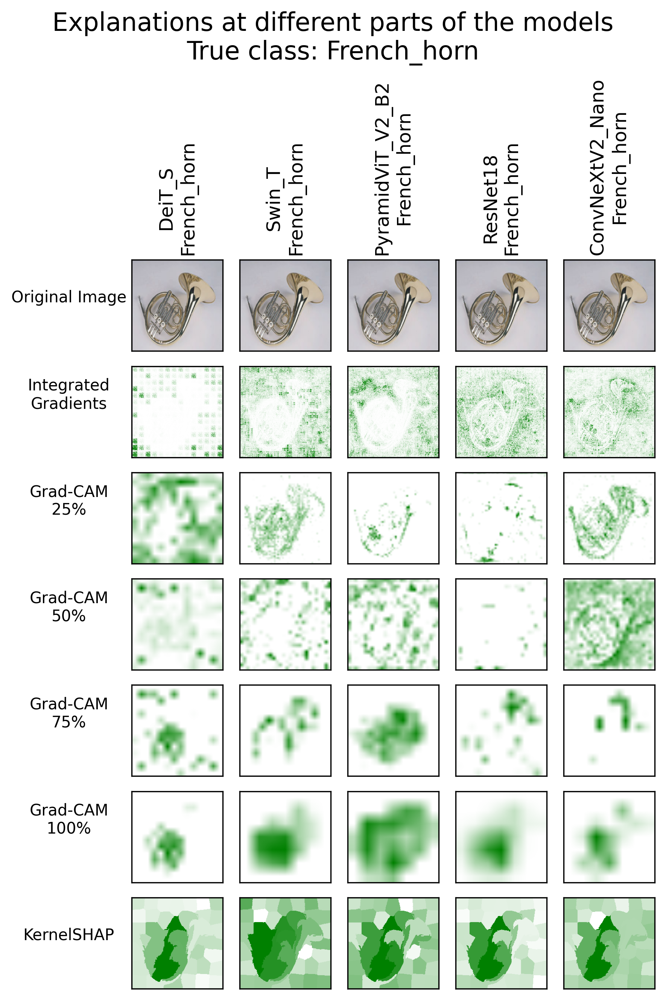

In [69]:
compute_for_ith_and_save_to_file(7)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

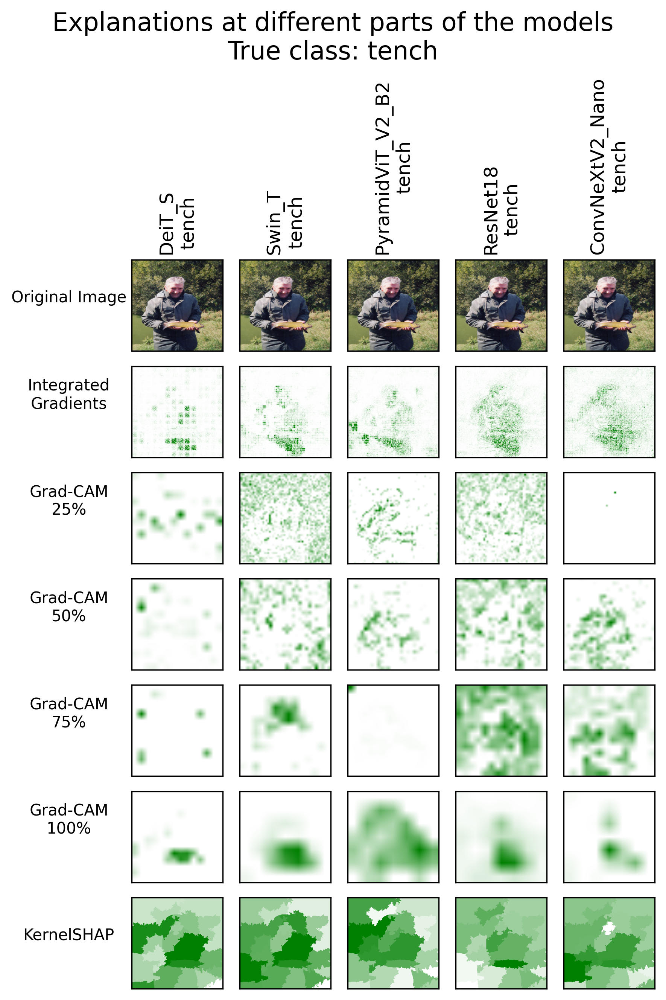

In [70]:
compute_for_ith_and_save_to_file(8)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

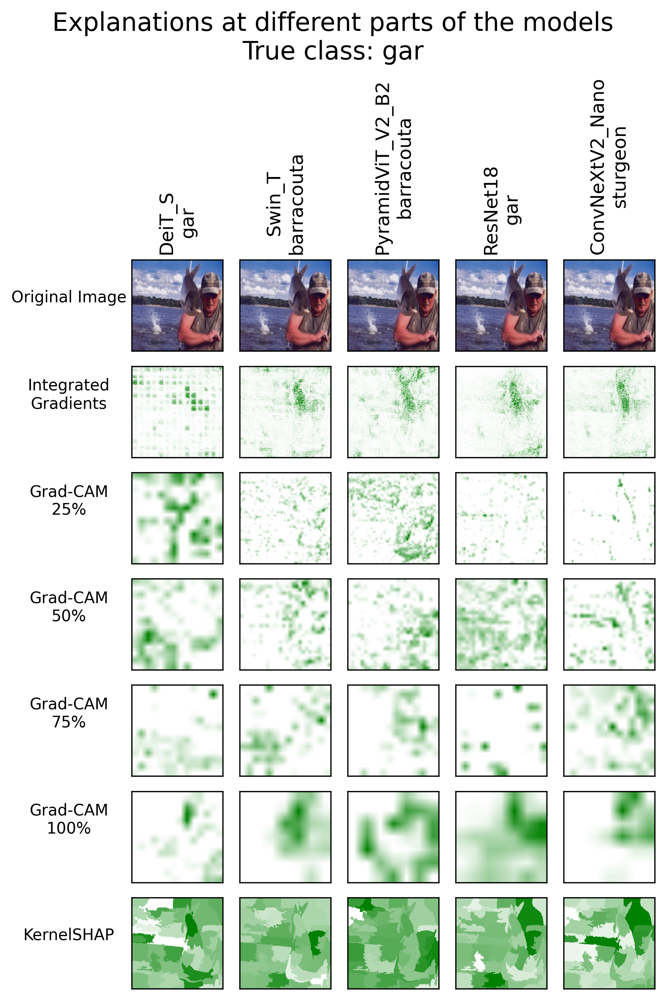

In [71]:
compute_for_ith_and_save_to_file(9)

Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/deit_small_patch16_224.fb_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swin_tiny_patch4_window7_224.ms_in1k
Loaded default imagenet-pretrained model: https://huggingface.co/timm/swi

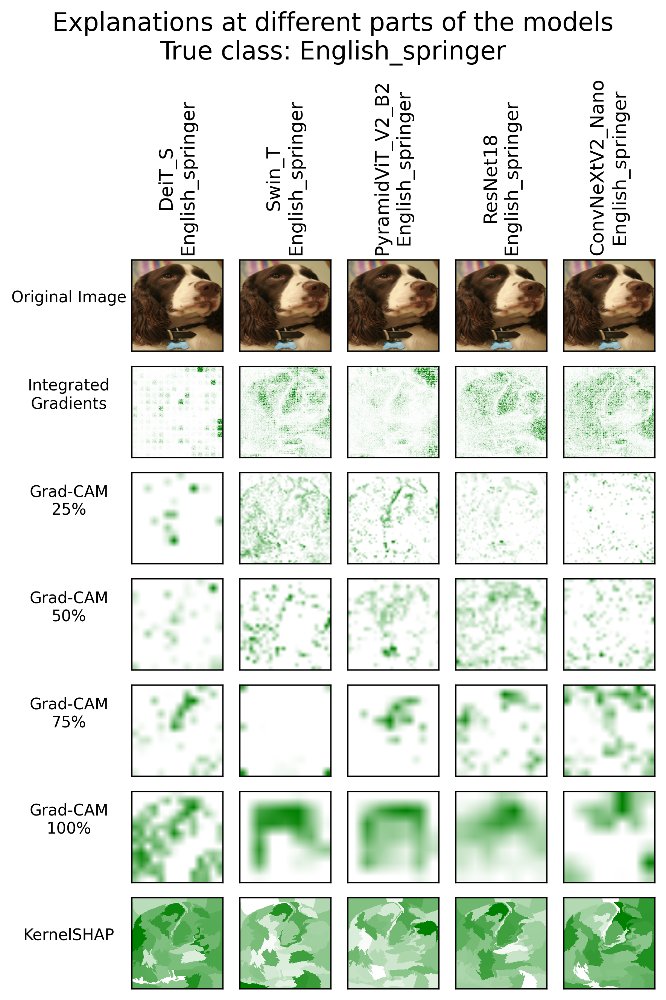

In [72]:
compute_for_ith_and_save_to_file(10)